# Analysing the drift of overnight AFM scans

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from pylabcontrol.core import Script
from mpl_toolkits.mplot3d import Axes3D


In [2]:
dir_afm_drift = r'C:\Users\Characterization\B26_scanning_probe\data\230110-17_47_10_afm_drift\data_subscripts'

## load the data

In [3]:
scans =[]
for scan in sorted(os.listdir(dir_afm_drift))[:]:
    scan_dir = os.path.join(dir_afm_drift,scan)
    data = Script.load_data(r'{}'.format(scan_dir))
    image = data['image_data']
    extent = data['extent']
    dimx = (extent[0],extent[1])
    dimy = (extent[3],extent[2])
    
    scans.append({"fname": scan, "data": image,"dimx":dimx,"dimy":dimy})

In [4]:
scans

[{'fname': '230110-17_47_10_afmscan_0000',
  'data': array([[10.12542815, 10.12542815, 10.12510353, ..., 10.12510353,
          10.12510353, 10.12510353],
         [10.12510353, 10.12510353, 10.12542815, ..., 10.12542815,
          10.1247789 , 10.12542815],
         [10.12510353, 10.12510353, 10.12510353, ..., 10.12445427,
          10.12542815, 10.12542815],
         ...,
         [10.12542815, 10.12510353, 10.12575278, ..., 10.12510353,
          10.12510353, 10.12542815],
         [10.12542815, 10.12542815, 10.12510353, ..., 10.12542815,
          10.12510353, 10.12510353],
         [10.1247789 , 10.12510353, 10.12542815, ..., 10.12542815,
          10.12575278, 10.12510353]]),
  'dimx': (15.0, 45.0),
  'dimy': (15.0, 45.0)},
 {'fname': '230110-17_52_31_afmscan_0001',
  'data': array([[10.12510353, 10.12510353, 10.12510353, ..., 10.12542815,
          10.12510353, 10.12510353],
         [10.12542815, 10.12542815, 10.12542815, ..., 10.12542815,
          10.12542815, 10.12542815],
 

## convert to units of `um`

In [5]:
def scale_xy(data,dimx,dimy):
    calib_xy = 20/75 #um/V
    nx,ny = np.shape(data)
    x = np.linspace(*dimx,nx)*calib_xy
    y = np.linspace(*dimy,ny)*calib_xy
    X,Y = np.meshgrid(x,y)
    return X,Y

def scale_z(data):
    calib_z = 1.5 # um/V this value should be 2, but from calibration sample one gets 1.5
    z = data*calib_z
    return z    

## plot the data

In [6]:
def plot_data3D(x,y,z,xlim=None,ylim=None,zlim=None,title=None,units="um"):
    if zlim is None:
        zlim = (np.nanmin(z),np.nanmax(z))
    else:
        assert len(zlim)==2
        assert zlim[0]<zlim[1]
     
    
    # making a 3D plot
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(x,y,z,
                    vmin=zlim[0],
                    vmax=zlim[1],
                    cmap='coolwarm_r',
                    linewidth=0,
                    antialiased=False)
    # modifing z axis
    ax.invert_zaxis()
    ax.set_zlim(reversed(zlim))
    
    if xlim is not None:
        ax.set_xlim(xlim)
    if ylim is not None:
        ax.set_ylim(ylim)
    if title is not None:
        plt.title(title)
        
    if units is "um":
        ax.set_xlabel("x position [um]")
        ax.set_ylabel("y position [um]")
        ax.set_zlabel("z position [um]")

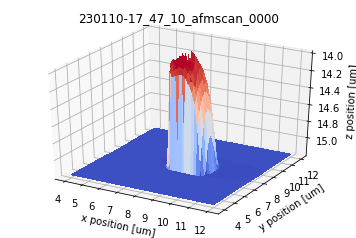

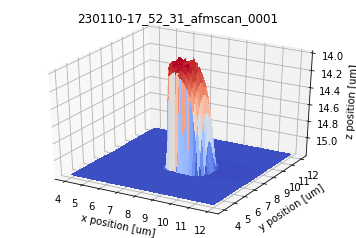

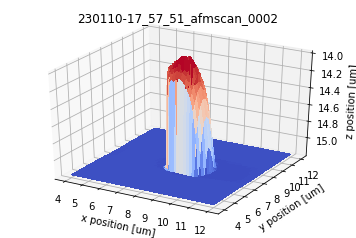

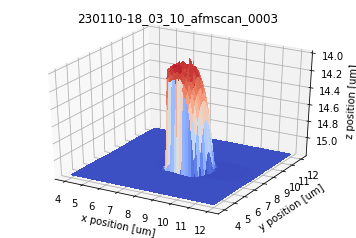

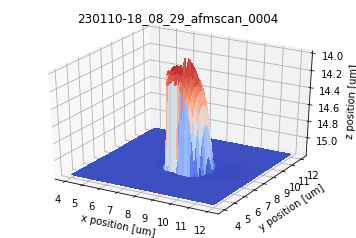

...

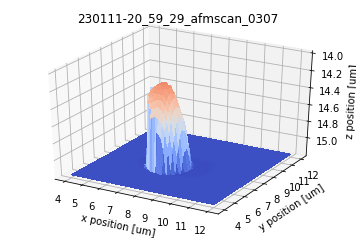

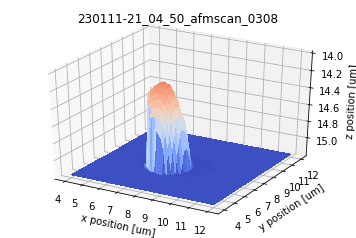

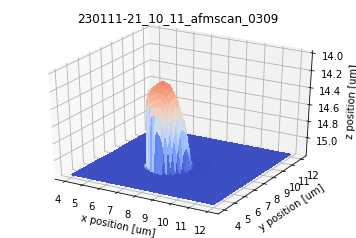

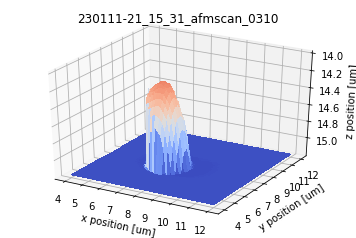

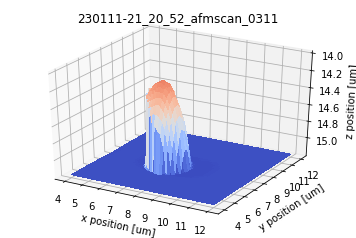

In [7]:
zlim=(14,15.2)
#zlim=None

for scan in scans:
    data = scan["data"]
    name = scan["fname"]
    dimx = scan["dimx"]
    dimy = scan["dimy"]
    # scale data
    x,y = scale_xy(data,dimx,dimy)
    z = scale_z(data)
    scan.update({"xyz_scaled" : (x,y,z)})
    plot_data3D(x,y,z,zlim=zlim,title=name)
    plt.savefig(r'C:\Users\Characterization\B26_scanning_probe\data\230110-17_47_10_afm_drift\analysis\3d_plots_scaled'+'/'+name+'.png',dpi=300)
    plt.show() 

In [8]:
scans

[{'fname': '230110-17_47_10_afmscan_0000',
  'data': array([[10.12542815, 10.12542815, 10.12510353, ..., 10.12510353,
          10.12510353, 10.12510353],
         [10.12510353, 10.12510353, 10.12542815, ..., 10.12542815,
          10.1247789 , 10.12542815],
         [10.12510353, 10.12510353, 10.12510353, ..., 10.12445427,
          10.12542815, 10.12542815],
         ...,
         [10.12542815, 10.12510353, 10.12575278, ..., 10.12510353,
          10.12510353, 10.12542815],
         [10.12542815, 10.12542815, 10.12510353, ..., 10.12542815,
          10.12510353, 10.12510353],
         [10.1247789 , 10.12510353, 10.12542815, ..., 10.12542815,
          10.12575278, 10.12510353]]),
  'dimx': (15.0, 45.0),
  'dimy': (15.0, 45.0),
  'xyz_scaled': (array([[ 4.        ,  4.08080808,  4.16161616, ..., 11.83838384,
           11.91919192, 12.        ],
          [ 4.        ,  4.08080808,  4.16161616, ..., 11.83838384,
           11.91919192, 12.        ],
          [ 4.        ,  4.08080808

### separate out data

## fitting a sphere to the data

### select out only the top of the dome

In [9]:
def select_dome(x,y,z,size=(10,10)):
    x_id, y_id = np.where(z==np.nanmin(z))
    x_id = x_id[0]
    y_id = y_id[0]

    x_cp = x[x_id-size[0]:x_id+size[0],y_id-size[1]:y_id+size[1]]
    y_cp = y[x_id-size[0]:x_id+size[0],y_id-size[1]:y_id+size[1]]
    z_cp = z[x_id-size[0]:x_id+size[0],y_id-size[1]:y_id+size[1]]
    return x_cp,y_cp,z_cp

### fitting a gaussian

In [10]:
from scipy.optimize import leastsq
def gaussian(height, center_x, center_y, width_x, width_y,offset):
    """Returns a gaussian function with the given parameters"""
    width_x = float(width_x)
    width_y = float(width_y)
    return lambda x,y: -height*np.exp(
                -(((center_x-x)/width_x)**2+((center_y-y)/width_y)**2)/2)+offset

def moments(data):
    """Returns (height, x, y, width_x, width_y)
    the gaussian parameters of a 2D distribution by calculating its
    moments """
    total = data.sum()
    X, Y = np.indices(data.shape)
    x = (X*data).sum()/total
    y = (Y*data).sum()/total
    col = data[:, int(y)]
    width_x = np.sqrt(np.abs((np.arange(col.size)-x)**2*col).sum()/col.sum())
    row = data[int(x), :]
    width_y = np.sqrt(np.abs((np.arange(row.size)-y)**2*row).sum()/row.sum())
    height = data.min()
    offset = data.max()
    return height, x, y, width_x, width_y, offset

def fitgaussian(data):
    """Returns (height, x, y, width_x, width_y)
    the gaussian parameters of a 2D distribution found by a fit"""
    params = moments(data)
    errorfunction = lambda p: np.ravel(gaussian(*p)(*np.indices(data.shape)) -
                                 data)
    p, success = leastsq(errorfunction, params)
    return p

In [11]:
def gen_xy(data):
    nx,ny = np.shape(data)
    x = range(nx)
    y = range(ny)
    X,Y = np.meshgrid(x,y)
    return X,Y

In [12]:
p_gauss=fitgaussian(z)

In [13]:
x_lin,y_lin = gen_xy(z)

In [14]:
#p_gauss=(28,10,10,10,10)
z_fit = gaussian(*p_gauss)(x_lin,y_lin)

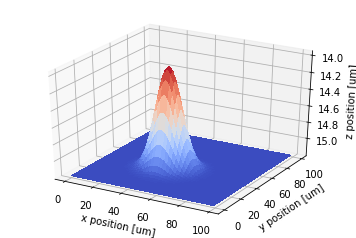

In [15]:
plot_data3D(x_lin,y_lin,z_fit)
plt.show()

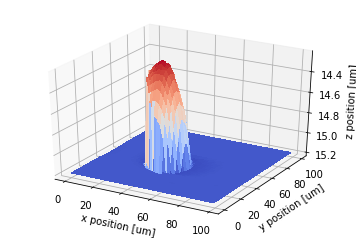

In [16]:
plot_data3D(x_lin,y_lin,z)
plt.show()

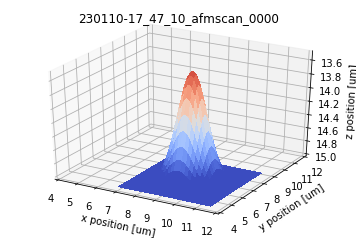

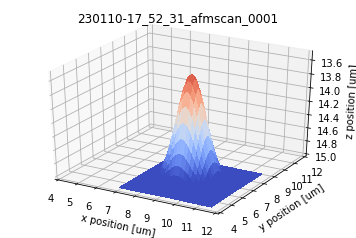

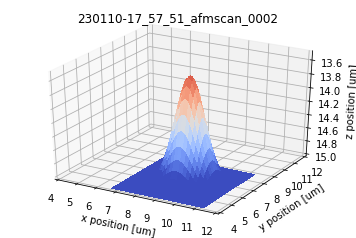

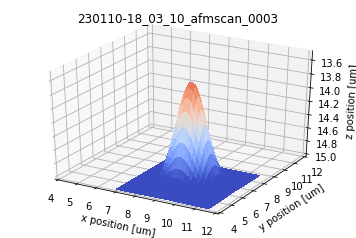

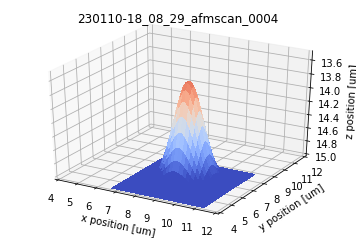

...

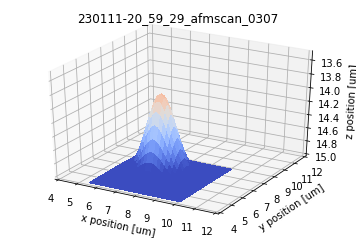

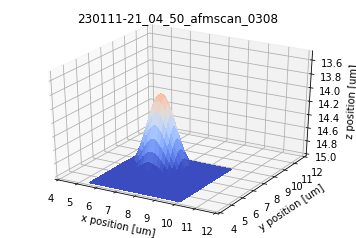

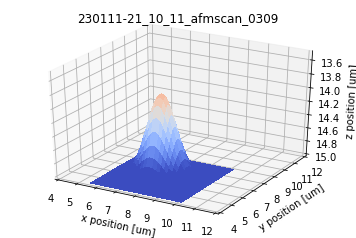

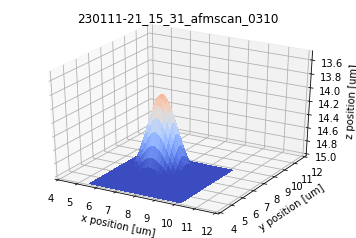

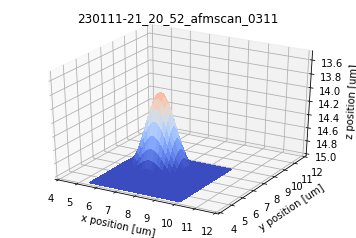

In [19]:
zlim=(13.5,15)
for scan in scans:
    name = scan["fname"]
    x,y,z = scan["xyz_scaled"]
    
    # crop data
    x_crop,y_crop,z_crop = select_dome(x,y,z,size=(30,30))
    
    x_lin,y_lin = gen_xy(z_crop)
    # fit data
    #popt,pcov=fit_sphere(x_crop,y_crop,z_crop)
    popt = fitgaussian(z_crop)
    scan.update({"popt" : tuple(popt)})
    #scan.update({"pcov" : tuple(pcov)})
    # plotting
    #fig = plt.figure()
    #ax = fig.add_subplot(111, projection='3d')
    #ax.scatter(x_crop,y_crop,z_crop)
    #ax.scatter(x_lin,y_lin,z_crop)
    # plot fit
    #z_fit = sphere((x_crop,y_crop),*popt)
    
    z_fit = gaussian(*popt)(x_lin,y_lin)
    #ax.scatter(x_lin,y_lin,z_fit)
    #ax.plot_surface(x_crop,y_crop,z_fit)
    #ax.set_zlim(zlim)
    #ax.invert_zaxis()  
    #ax.scatter(x_lin,y_lin,z_fit)
    
    plot_data3D(x_crop,y_crop,z_fit,xlim=(4,12),ylim=(4,12),zlim=zlim,title=name)
    
    #fig.text(0.5,0.3,s="r =%.3f"%popt[-1])
    plt.savefig(r'C:\Users\Characterization\B26_scanning_probe\data\230110-17_47_10_afm_drift\analysis\3d_plots_fit'+'/'+name+'.png',dpi=300)
    plt.show()

In [20]:
scans[0]

{'fname': '230110-17_47_10_afmscan_0000',
 'data': array([[10.12542815, 10.12542815, 10.12510353, ..., 10.12510353,
         10.12510353, 10.12510353],
        [10.12510353, 10.12510353, 10.12542815, ..., 10.12542815,
         10.1247789 , 10.12542815],
        [10.12510353, 10.12510353, 10.12510353, ..., 10.12445427,
         10.12542815, 10.12542815],
        ...,
        [10.12542815, 10.12510353, 10.12575278, ..., 10.12510353,
         10.12510353, 10.12542815],
        [10.12542815, 10.12542815, 10.12510353, ..., 10.12542815,
         10.12510353, 10.12510353],
        [10.1247789 , 10.12510353, 10.12542815, ..., 10.12542815,
         10.12575278, 10.12510353]]),
 'dimx': (15.0, 45.0),
 'dimy': (15.0, 45.0),
 'xyz_scaled': (array([[ 4.        ,  4.08080808,  4.16161616, ..., 11.83838384,
          11.91919192, 12.        ],
         [ 4.        ,  4.08080808,  4.16161616, ..., 11.83838384,
          11.91919192, 12.        ],
         [ 4.        ,  4.08080808,  4.16161616, ..., 1

In [111]:
from datetime import datetime
popt_all = []
for scan in scans:
    name = scan["fname"]
    datetime_str= name[:15]
    time_abs = datetime.strptime(datetime_str,'%y%m%d-%H_%M_%S')
    x,y,z = scan["xyz_scaled"]
    popt= scan["popt"]
    scan.update({'time_abs':time_abs})
    
    height, center_x, center_y, width_x, width_y,offset = popt
    popt_all.append([*popt])
    
popt_all=np.asarray(popt_all)

In [115]:
# fixing time
t0 = scans[0]["time"]
for scan in scans:
    ti = scan['time_abs']
    time_dt = ti-t0
    # correct for multiple days
    time_dt = time_dt.seconds + time_dt.days * 86400
    scan.update({'time_dt':time_dt})

In [120]:
t_minutes = [scan['time_dt'] //60 for scan in scans]
t_minutes

[0,
 5,
 10,
 16,
 21,
 26,
 31,
 37,
 42,
 47,
 53,
 58,
 63,
 69,
 74,
 79,
 85,
 90,
 95,
 101,
 106,
 111,
 116,
 122,
 127,
 132,
 138,
 143,
 148,
 153,
 159,
 164,
 169,
 175,
 180,
 185,
 191,
 196,
 201,
 207,
 212,
 217,
 222,
 228,
 233,
 238,
 244,
 249,
 254,
 260,
 265,
 270,
 275,
 281,
 286,
 291,
 297,
 302,
 307,
 313,
 318,
 323,
 329,
 334,
 339,
 344,
 350,
 355,
 360,
 366,
 371,
 376,
 381,
 387,
 392,
 397,
 403,
 408,
 413,
 419,
 424,
 429,
 435,
 440,
 445,
 450,
 456,
 461,
 466,
 472,
 477,
 482,
 487,
 493,
 498,
 503,
 509,
 514,
 519,
 525,
 530,
 535,
 541,
 546,
 551,
 557,
 562,
 567,
 573,
 578,
 583,
 588,
 594,
 599,
 604,
 610,
 615,
 620,
 625,
 631,
 636,
 641,
 647,
 652,
 657,
 663,
 668,
 673,
 679,
 684,
 689,
 694,
 700,
 705,
 710,
 716,
 721,
 726,
 731,
 737,
 742,
 747,
 753,
 758,
 763,
 769,
 774,
 779,
 785,
 790,
 795,
 800,
 806,
 811,
 816,
 822,
 827,
 832,
 838,
 843,
 848,
 853,
 859,
 864,
 869,
 875,
 880,
 885,
 891,
 896,
 

In [135]:
30*20/75

8.0

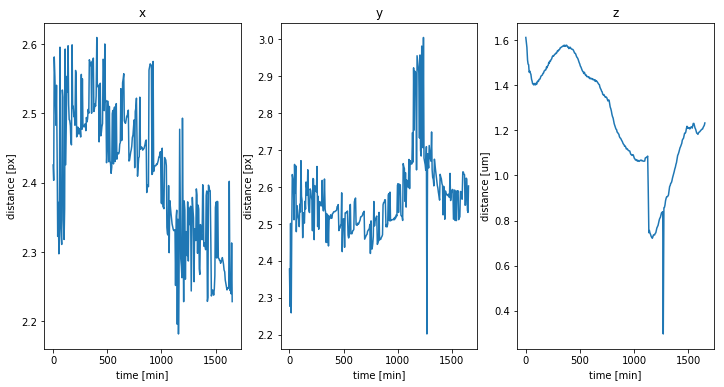

In [137]:
fig, (ax0, ax1, ax2) = plt.subplots(nrows=1, ncols=3, sharex=False,figsize=(12, 6))

# x axis
ax0.plot(t_minutes,popt_all[:,1]*0.08)
ax0.set_xlabel('time [min]')
ax0.set_ylabel('distance [px]')
ax0.title.set_text('x')
# y axis
ax1.plot(t_minutes,popt_all[:,2]*0.08)
ax1.set_xlabel('time [min]')
ax1.set_ylabel('distance [px]')
ax1.title.set_text('y')
# z axis
ax2.plot(t_minutes,popt_all[:,0])
ax2.set_xlabel('time [min]')
ax2.set_ylabel('distance [um]')
ax2.title.set_text('z')

plt.savefig(r'C:\Users\Characterization\B26_scanning_probe\data\230110-17_47_10_afm_drift\analysis'+'\drift_xyz.png',dpi=300)
plt.show()

## smoothing the data

## fitting a sphere to the data

In [ ]:
x = range(100)
y = range(100)
X,Y = np.meshgrid(x,y)
Z = sphere((X,Y),x0=50,y0=50,z0=0,r=20,bg=3)

## plotting
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X,Y,Z,cmap='coolwarm')
plt.show()

## testing the fitting routine

In [ ]:
fit_sphere(test_data,p0=guess_p0(test_data))

## Lambda calulus

In [139]:
C_tot = 460e-9
BW =1/(2*np.pi *150 *(0.047e-6 + C_tot))
BW

2092.76716754629

In [140]:
100/379 

0.2638522427440633

In [141]:
0.2638/1.03

0.25611650485436893